In [1]:
import numpy as np
import matplotlib.pyplot as plt
import aopy
import os
import pandas as pds
from db import dbfunctions as db
from ipywidgets import interactive, widgets
import scipy
import h5py
from tqdm.auto import tqdm 
import seaborn as sn
import sklearn
from sklearn.decomposition import PCA, FactorAnalysis
from itertools import compress
import multiprocessing as mp
import time
import math
from scipy.fft import fft
import glob
from datetime import date

/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/one/alf/files.py:10: FutureWarning: `one.alf.files` will be removed in version 3.0. Use `one.alf.path` instead.
  warnings.warn(


In [2]:
# Paths
data_path_preproc = '/media/moor-data/preprocessed.new/'
kilosort_dir = '/media/moor-data/preprocessed/kilosort'
base_save_dir = "/media/moor-data/results/Ryan/neuropixel_targeting/"
save_dir = "/media/moor-data/results/Ryan/neuropixel_targeting/np_analysis_preproc_data"
np_preproc_data_folder = 'np_analysis_preproc_data'
ecog_dec_acc_file_name = 'npinsert_ecog_decoding_all'

subject = 'affi'
align_events = ['TARGET ONSET', 'GO CUE', 'MOVEMENT ONSET']

In [3]:
good_unit_labels = {}

### Quality metric parameters ###
# 1. Presence Ratio
epoch_size = 10 # [s]
if subject == 'affi':
    min_trial_prop = 1
elif subject == 'beignet':
    min_trial_prop = 1 # presence ratio threshold to classify a unit as a good unit

# 2. Firing Rate
fr_trial_window_size=17

# 3. ISI violations
min_refractory_period = 1 # [ms]
isi_perc_thresh = 0.02
isi_count_thresh = 100

# Load data

## Load preprocessed data to run quality metrics on

In [5]:
start = time.time()
aopy.utils.release_memory_limit()
df, rasters, preproc_metadata = aopy.data.base.pkl_read(f"{subject}_np_preprocessed_eye_constrained", os.path.join(base_save_dir, np_preproc_data_folder))
print(f"{np.round((time.time()-start)/60)} min to load preprocessed data")
nrecs = preproc_metadata['nrecs']
recording_site = preproc_metadata['recording_sites'] # will be the same for all align events
implants = ['NPinsert72' if preproc_metadata['implant'][irec] == 'NP_Insert72' else 'NPinsert137' for irec in range(len(preproc_metadata['implant']))] #Rename because name in bmi3d is slightly different (TODO)
dates = np.unique(df['date'])

16.0 min to load preprocessed data


## Load kilosort drift traces

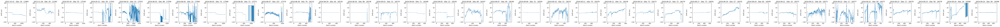

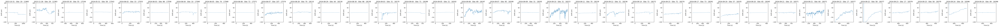

In [6]:
seconds_per_batch = 2

fig, ax = plt.subplots(1, nrecs, figsize=(nrecs*3, 3))
fig2, ax2 = plt.subplots(1, nrecs, figsize=(nrecs*3, 3))
ks_drift = []
for ipenetration in range(nrecs):
    date = list(df['date'][df['penetration']==ipenetration])[0]
    te_id = list(df['te_id'][df['penetration']==ipenetration])[0]
    port = int(list(df['port'][df['penetration']==ipenetration])[0])
    recording_site = int(list(df['recording_site'][df['penetration']==ipenetration])[0])
    try:
        if te_id < 0:
            try:
                concat_data_dir = f'{date}_Neuropixel_ks_{subject}_bottom_port1'
                dshift = aopy.data.load_ks_output(kilosort_dir, concat_data_dir, flag='rez')['dshift']
            except:
                concat_data_dir = f'{date}_Neuropixel_ks_{subject}_site{recording_site}_bottom_port1'
                dshift = aopy.data.load_ks_output(kilosort_dir, concat_data_dir, flag='rez')['dshift']
        else:
            concat_data_dir = f'{date}_Neuropixel_{subject}_te{te_id}/port{port}/kilosort4/ops.npy'
            dshift = np.load(os.path.join(kilosort_dir, concat_data_dir), allow_pickle=True).item()['dshift'].T
    except:
        continue
    ks_drift.append(np.array(dshift))
    ax[ipenetration].plot(np.array(dshift).T, linewidth=0.5)
    ax[ipenetration].set(xlabel='Batch number', ylabel='Drift (um)', title=f"{date} - Site: {recording_site} - {te_id}", ylim=(-100, 100))
    
    # Look only at the trials used to compute quality metrics
    first_good_trial_idx = np.where(df[df['penetration']==ipenetration]['good_trial'])[0][0]
    start_time = df[df['penetration']==ipenetration].reset_index().iloc[first_good_trial_idx]['reward_start_time'] #[s]
    start_time_min = df[df['penetration']==ipenetration].reset_index().iloc[first_good_trial_idx]['reward_start_time']/60 #[s]
    first_batch = int(np.ceil(start_time/seconds_per_batch))
    
    last_good_trial_idx = np.where(df[df['penetration']==ipenetration]['good_trial'])[0][-1]
    end_time = df[df['penetration']==ipenetration].reset_index().iloc[last_good_trial_idx]['reward_start_time'] #[s]
    end_time_min = df[df['penetration']==ipenetration].reset_index().iloc[last_good_trial_idx]['reward_start_time']/60 #[s]
    last_batch = int(np.ceil(end_time/seconds_per_batch))
    
    ax2[ipenetration].plot(np.arange(first_batch, last_batch)*seconds_per_batch, np.array(dshift[:,first_batch:last_batch]).T, linewidth=0.5)
    ax2[ipenetration].set(xlabel='Time [s]', ylabel='Drift (um)', title=f"{date} - Site: {recording_site} - {te_id}", ylim=(-100, 100))
    
fig.tight_layout()
fig2.tight_layout()
plt.show()
drift = {'ks_drift': ks_drift}

In [7]:
# drift['drift_max'] = [np.abs(np.max(ks_drift[idate]) - np.min(ks_drift[idate])) for idate in range(len(dates))]
# drift['drift_timevar'] = [np.var(np.mean(ks_drift[idate], axis=0)) for idate in range(len(dates))]
# drift['drift_depthvar'] = [np.mean(np.var(ks_drift[idate], axis=0)) for idate in range(len(dates))]

In [8]:
# fig, ax = plt.subplots(1,1,figsize=(8,4))
# dmap = ax.pcolor(np.array([drift['drift_depthvar']/np.max(drift['drift_depthvar']), drift['drift_timevar']/np.max(drift['drift_timevar']), drift['drift_max']/np.max(drift['drift_max']) ]))
# ax.set_xticks(np.arange(len(dates))+0.5, labels=recording_site)
# ax.set_yticks(np.arange(3)+0.5, labels=['Depth Var', 'Time Var', 'Range [um]'])
# ax.set(xlabel="Recording Site", title='Normalized Drift Characteristics')
# cb = plt.colorbar(dmap)

# plt.show()

# Apply individual QC metrics to units that are loaded

https://github.com/AllenInstitute/ecephys_spike_sorting/blob/master/ecephys_spike_sorting/modules/quality_metrics/README.md

In [9]:
quality_metrics = {}

## Presence Ratio

In [10]:
def calc_presence_ratio(data, min_trial_prop=0.9, return_details=False):
    '''
    Find which units are active on a high proportion of trials.
    
    Args:
        data (ntime, ntrials, nunit):
        min_trial_prop (float): proportion of trials a unit must have a spike on 
        
    Returns:
        presence_ratio (nunit): Proportion of trials that have a spike for each unit
        present_units (nunit): Binary mask if a unit is present or not
        presence_details (ntrials, nunit): Optional if 'return_details=True' Identifies which trials each unit is active on 
    '''        
    _, ntrials, _ = data.shape
    
    present_trials = np.sum(np.max(data>0, axis=0), axis=0) # Number of trials with a spike for each unit
    
    presence_ratio = (present_trials/ntrials)
    if return_details:
        return presence_ratio, presence_ratio>=min_trial_prop, np.max(data>0, axis=0)
    else:
        return presence_ratio, presence_ratio>=min_trial_prop
    


2 473


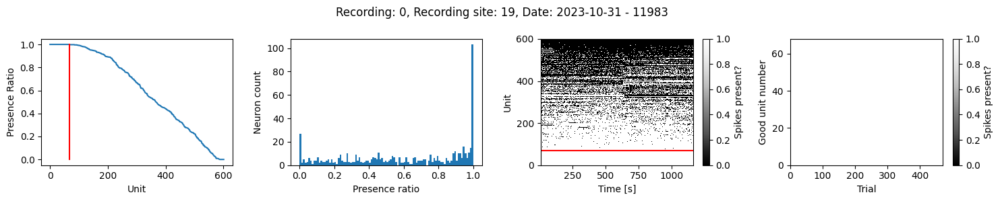

5 415


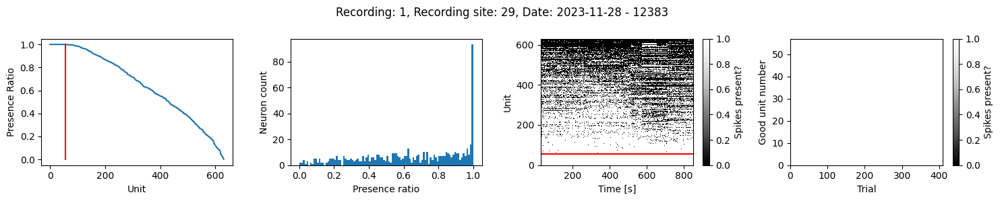

222 367


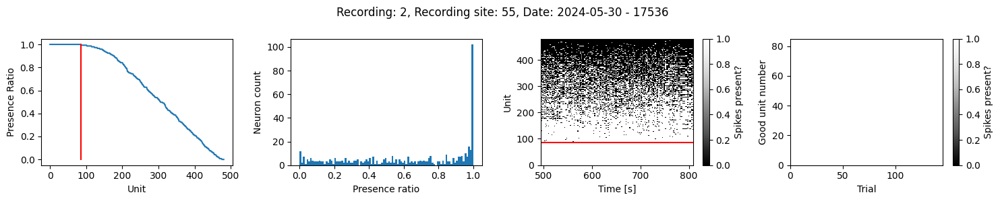

0 266


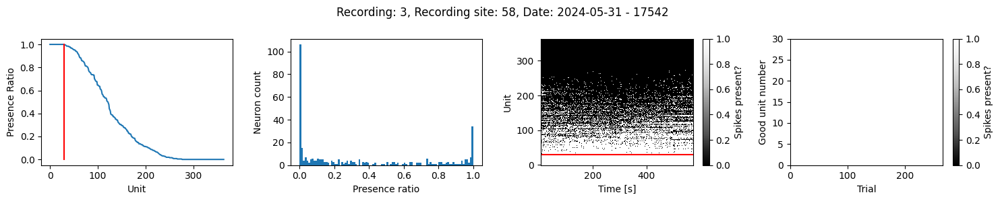

0 213


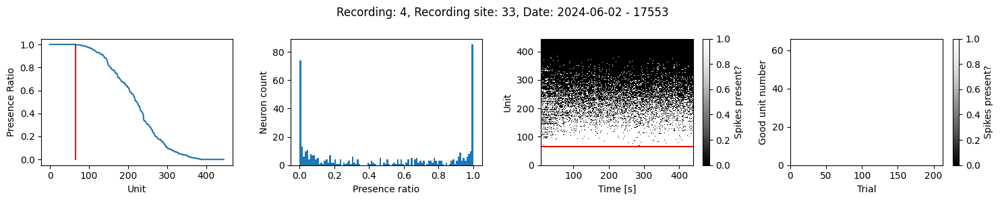

1 372


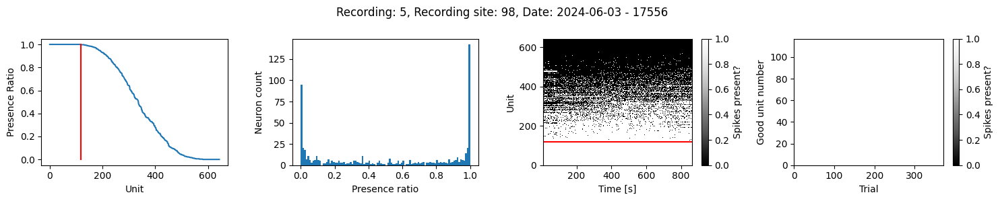

0 210


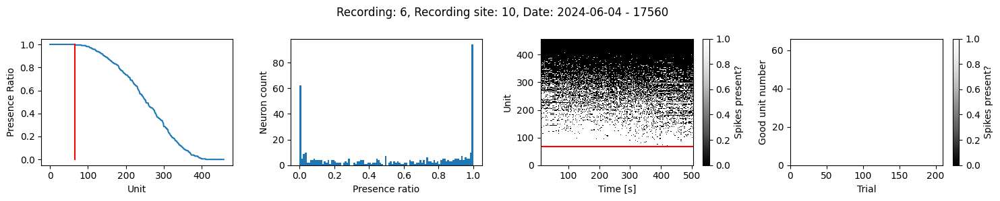

1 216


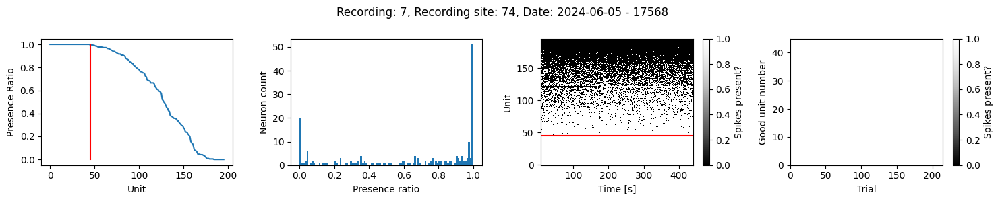

0 233


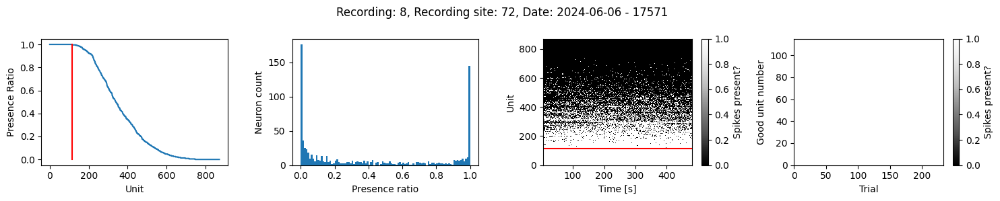

1 256


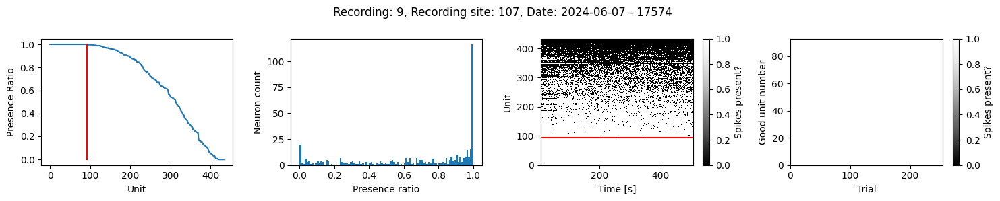

1 298


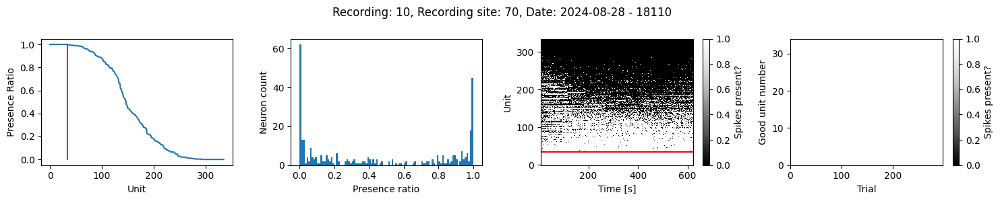

0 245


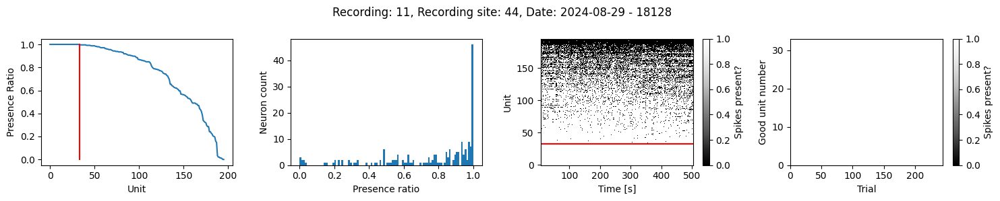

0 230


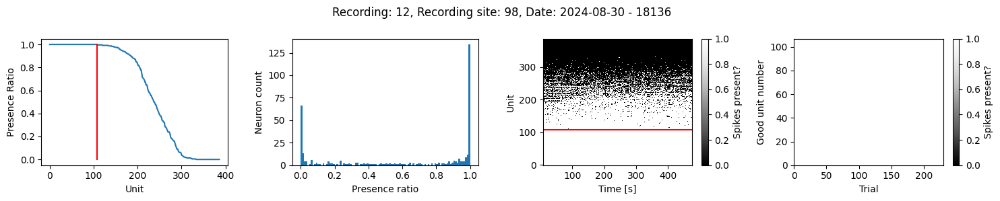

1 224


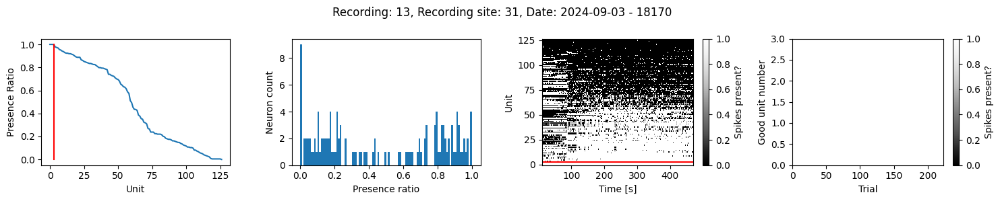

7 411


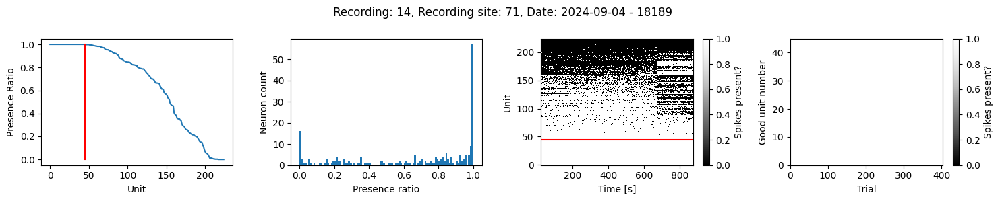

0 128


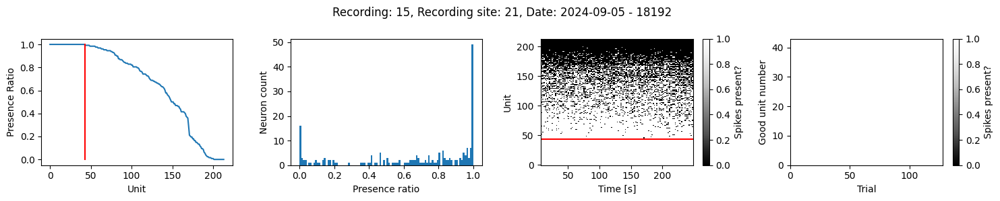

5 342


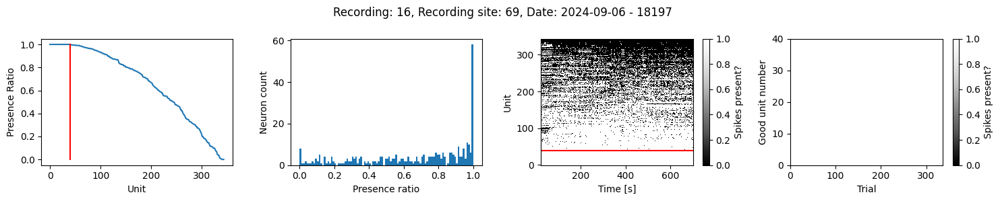

0 314


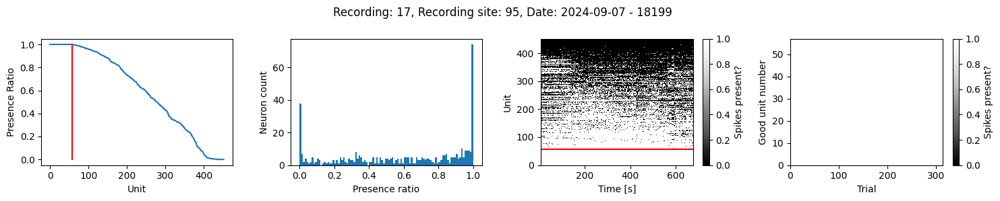

1 318


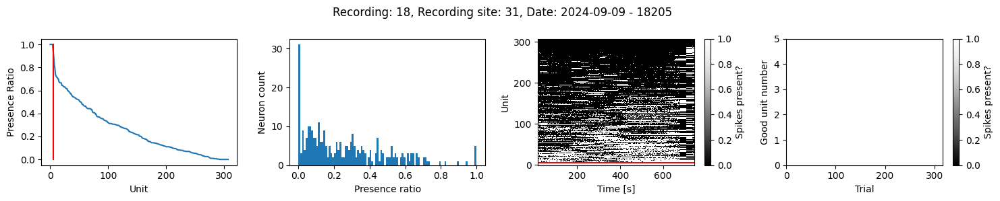

27 372


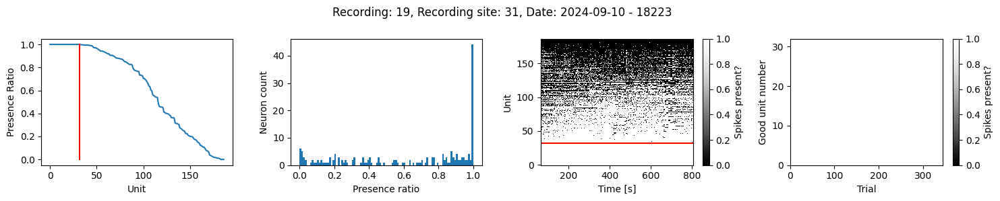

0 256


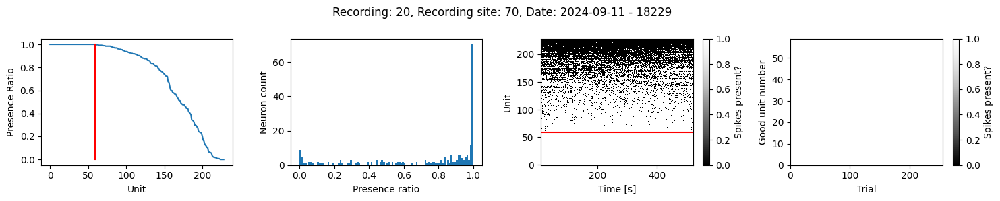

0 245


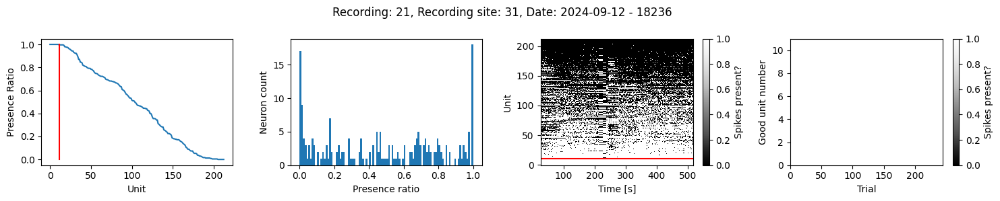

3 255


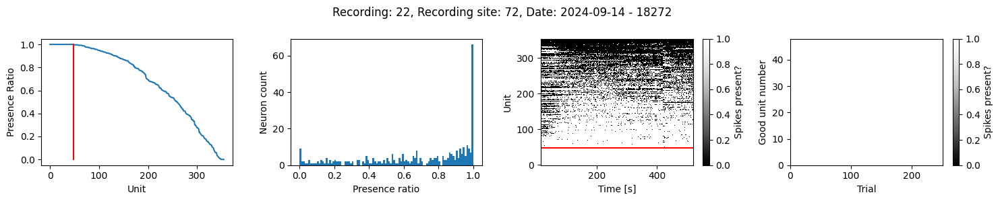

12 263


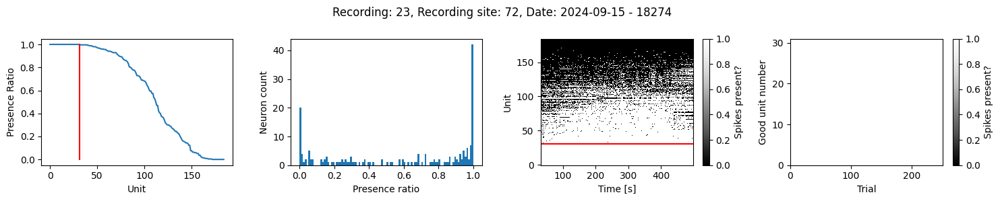

0 342


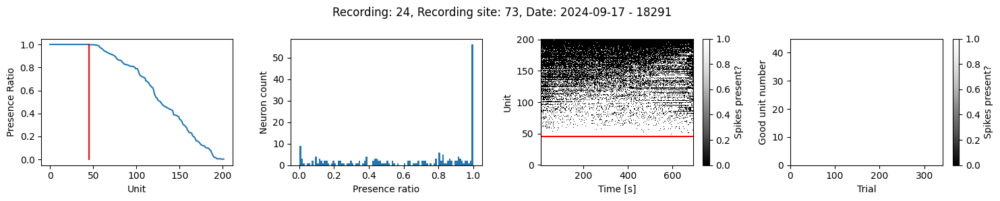

1 236


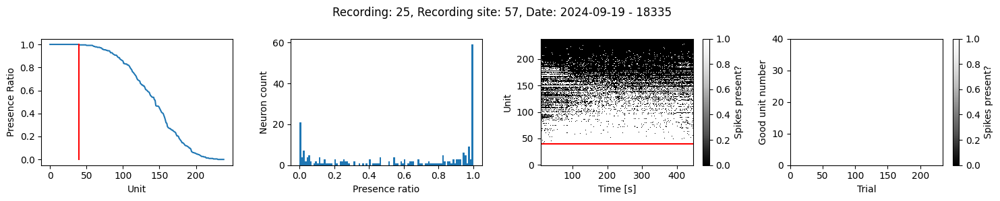

3 211


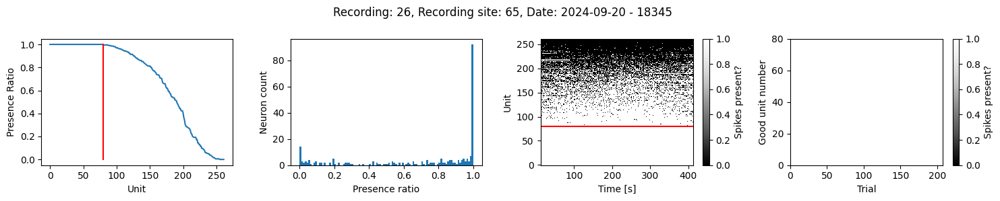

80 465


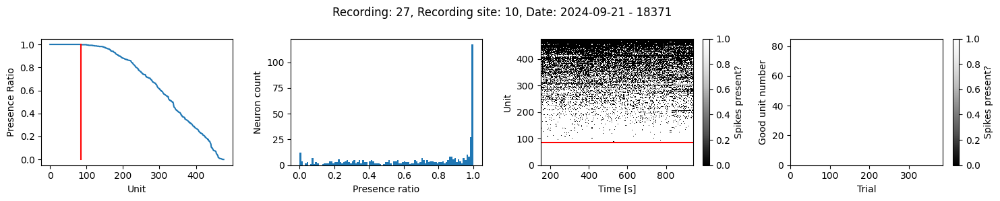

80 465


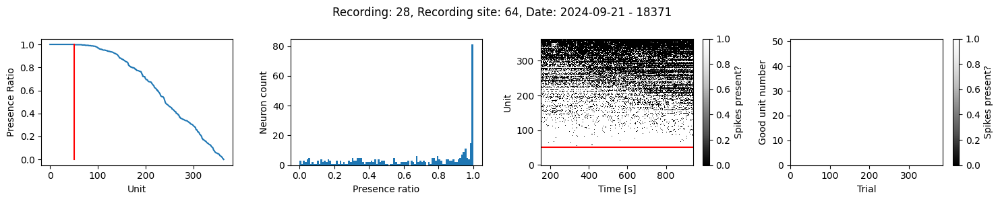

148 367


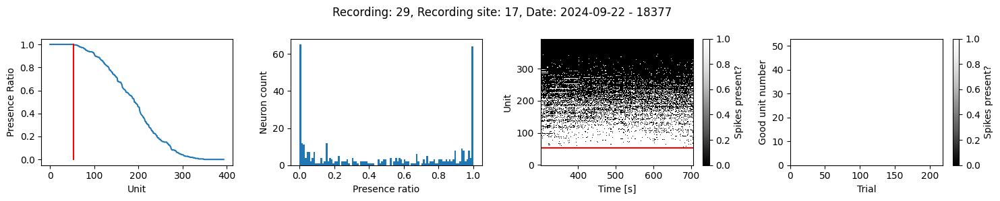

148 367


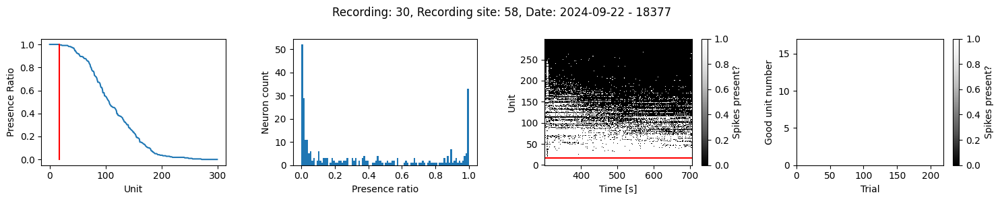

129 352


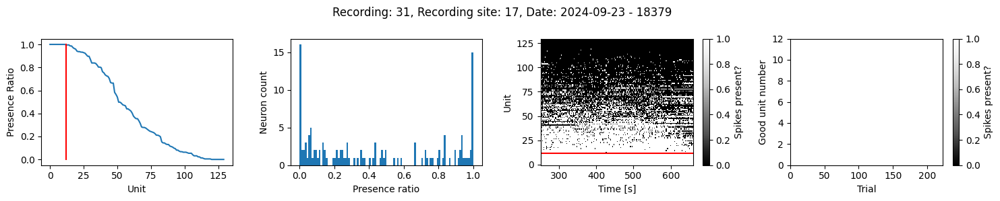

129 352


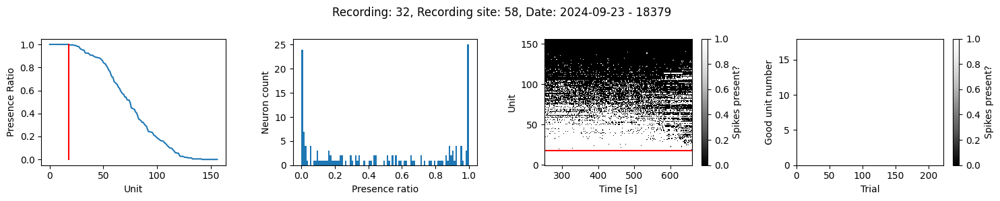

236 442


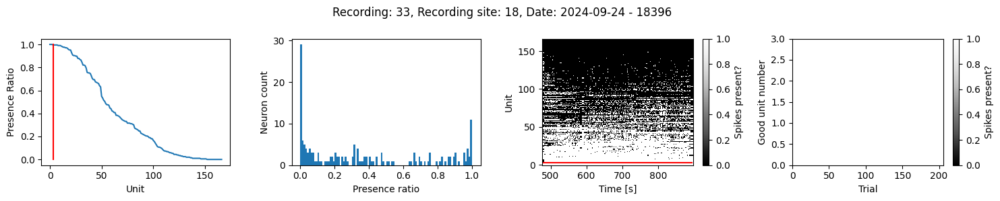

236 442


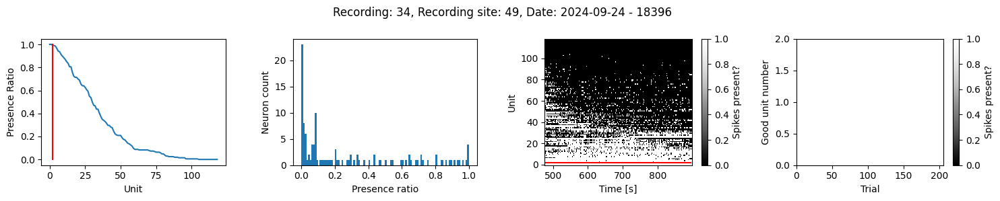

In [12]:
quality_metrics['presence_ratio'] = []
quality_metrics['present_units'] = []
quality_metrics['present_unit_labels'] = []
if min_trial_prop > 0.99:
    bins = 100
else:
    bins = int(np.round(1/(1-min_trial_prop)))
for irec in range(nrecs):
    recording_site = list(df[df['penetration']==irec]['recording_site'])[0]
    start_trial_idx = np.where(list(df[df['penetration']==irec]['good_trial']))[0][0]
    end_trial_idx = np.where(list(df[df['penetration']==irec]['good_trial']))[0][-1]
    te_id = list(df[df['penetration']==irec]['te_id'])[0]
    
    # if te_id == 18223:
    #     start_time = 60 #[s]
    #     start_trial_idx = np.where(np.array(df[df['penetration']==irec]['reward_start_time']) > start_time)[0][0]
    #     end_trial_idx = start_trial_idx + 360
    # elif te_id == 18274:
    #     start_time = 30 #[s]
    #     start_trial_idx = np.where(np.array(df[df['penetration']==irec]['reward_start_time']) > start_time)[0][0]
    #     end_trial_idx = start_trial_idx + 360
    # elif te_id == 18371:
    #     start_time = 150 #[s]
    #     start_trial_idx = np.where(np.array(df[df['penetration']==irec]['reward_start_time']) > start_time)[0][0]
    #     end_trial_idx = start_trial_idx + 360
    # elif te_id == 18377:
    #     start_time = 300 #[s]
    #     start_trial_idx = np.where(np.array(df[df['penetration']==irec]['reward_start_time']) > start_time)[0][0]
    #     end_trial_idx = start_trial_idx + 360
    # elif te_id == 18379:
    #     start_time = 250 #[s]
    #     start_trial_idx = np.where(np.array(df[df['penetration']==irec]['reward_start_time']) > start_time)[0][0]
    #     end_trial_idx = start_trial_idx + 360
    # elif te_id == 18396:
    #     start_time = 475 #[s]
    #     start_trial_idx = np.where(np.array(df[df['penetration']==irec]['reward_start_time']) > start_time)[0][0]
    #     end_trial_idx = start_trial_idx + 360
    
    print(start_trial_idx, end_trial_idx)
    
    presence_ratio, present_units, presence_details = calc_presence_ratio(rasters['neural'][align_events[-1]][irec][:,start_trial_idx:end_trial_idx,:], min_trial_prop=min_trial_prop, return_details=True)
    # ntrials = rasters['neural'][align_events[-1]][irec].shape[1]
    
    fig, ax = plt.subplots(1,4,figsize=(15,3))
    ax[0].plot(presence_ratio[np.flip(np.argsort(presence_ratio))])
    ax[0].plot([np.sum(present_units), np.sum(present_units)], [0,1], 'r', label='Neuron cutoff')
    ax[0].set(xlabel='Unit', ylabel='Presence Ratio')
    
    ax[1].hist(presence_ratio, bins=bins)
    ax[1].set(xlabel='Presence ratio', ylabel='Neuron count')
    
    # pdetails_im = ax[2].pcolor(presence_details[:,np.flip(np.argsort(presence_ratio))].T,cmap='Greys_r', vmin=0, vmax=1)
    # ax[2].plot([0, end_trial_idx-start_trial_idx], [np.sum(present_units), np.sum(present_units)], 'r', label='Neuron cutoff')
    
    trial_times = np.array(df['reward_start_time'][df['penetration']==irec])[start_trial_idx:end_trial_idx]
    pdetails_im = ax[2].pcolor(trial_times, np.arange(presence_details.shape[1]), presence_details[:,np.flip(np.argsort(presence_ratio))].T,cmap='Greys_r', vmin=0, vmax=1)
    ax[2].plot([trial_times[0], trial_times[-1]], [np.sum(present_units), np.sum(present_units)], 'r', label='Neuron cutoff')
    ax[2].set(xlabel='Time [s]', ylabel='Unit')
    cb = plt.colorbar(pdetails_im, label='Spikes present?')
              
    pdetails_im = ax[3].pcolor(presence_details[:,present_units].T,cmap='Greys_r', vmin=0, vmax=1)
    ax[3].set(xlabel='Trial', ylabel='Good unit number')
    cb = plt.colorbar(pdetails_im, label='Spikes present?')
        
    plt.suptitle(f"Recording: {irec}, Recording site: {recording_site}, Date: {list(df['date'][df['penetration']==irec])[0]} - {te_id}")
    fig.tight_layout()
    plt.show()
    
    quality_metrics['presence_ratio'].append(presence_ratio)
    quality_metrics['present_units'].append(present_units)
    quality_metrics['present_unit_labels'].append(list(df['unit_labels'][df['penetration']==irec])[0][present_units])

## Firing Rate

In [11]:
from statsmodels.stats.multitest import fdrcorrection
def get_stable_FR_units(data, wind_size=17, alpha=0.05, correction='bonferroni', return_significance=False):
    '''
    Args:
        data (ntime, ntrial, nunit): Binned and trial aligned firing rate
        wind_size (int): Size of rolling average window [trials] used to smooth firing rate. Typically large enough to average out any tuning seen by a neuron
        alpha (float): significance level - units with a significant trend are removed
        correction (string): Type of multiple comparison correction to do ('bonferroni' or 'fdr') 
        return_significance (bool): If the linear fit significance should be returned 
    '''        
    ntime, ntrials, nunits = data.shape
    
    avg_fr_each_trial = np.mean(data, axis=0)
    smooth_avg_fr_each_trial = aopy.analysis.base.calc_rolling_average(avg_fr_each_trial, window_size=wind_size) # move window size to input args
    
    # # stable_units = np.std(smooth_avg_fr_each_trial/(np.max(smooth_avg_fr_each_trial,axis=0)-np.min(smooth_avg_fr_each_trial,axis=0)), axis=0) < 0.25 # move threshold to input args
    pccs = []
    [pccs.append(aopy.analysis.base.linear_fit_analysis2D(np.arange(ntrials), smooth_avg_fr_each_trial[:,iunit])[3]) for iunit in range(nunits)]
    
    if correction == 'bonferroni':
        stable_units = np.array(pccs) > (alpha/nunits)
    elif correction == 'fdr':
        stable_units = np.logical_not(fdrcorrection(np.array(pccs), alpha=alpha)[0])
    else:
        stable_units = np.array(pccs) > alpha
        print('Please enter a valid multiple comparison method')
    
    if return_significance:
        return stable_units, np.array(pccs)
    else:
        return stable_units

In [12]:
fr_trial_window_size=3
quality_metrics['stable_fr_units'] = []
quality_metrics['stable_fr_units_labels'] = []
quality_metrics['stable_fr_units_pcc'] = []
for irec in range(nrecs):
    ntrials = np.where(df[df['penetration']==irec]['good_trial'])[0][-1]
    _, present_units = calc_presence_ratio(rasters['neural'][align_events[-1]][irec][:,:ntrials,:], min_trial_prop=0.3, return_details=False) # set a low minimum trial threshold so neurons with very few spikes aren't used
    
    stable_units, pccs =  get_stable_FR_units(rasters['neural'][align_events[-1]][irec][:,:ntrials,present_units], wind_size=fr_trial_window_size, alpha=0.01, correction='fdr', return_significance=True)
    
    quality_metrics['stable_fr_units'].append(np.where(present_units)[0][stable_units])
    quality_metrics['stable_fr_units_pcc'].append(pccs[stable_units])
    quality_metrics['stable_fr_units_labels'] = list(df['unit_labels'][df['penetration']==irec])[0][np.where(present_units)[0][stable_units]]

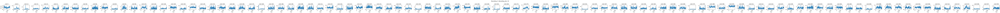

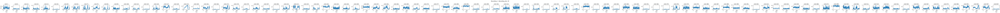

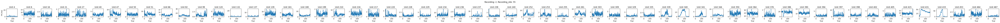

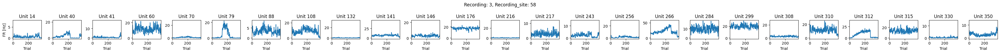

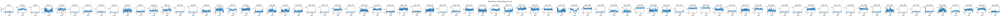

...

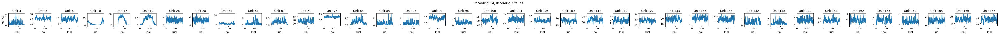

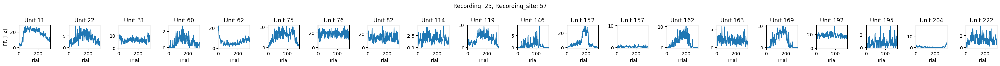

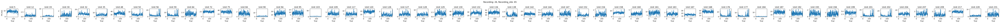

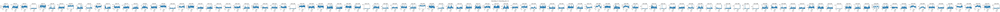

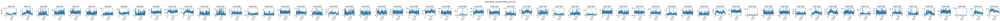

IndexError: index 147 is out of bounds for axis 0 with size 130

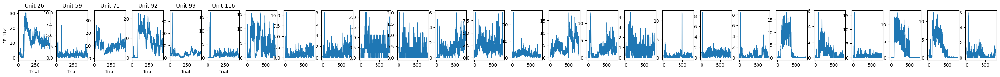

In [13]:
for irec in range(nrecs):
    ntrials = np.where(df[df['penetration']==irec]['good_trial'])[0][-1]
    nstable_units = len(quality_metrics['stable_fr_units'][irec])
    if nstable_units == 0:
        continue
    else:
        fig, ax = plt.subplots(1,nstable_units,figsize=(nstable_units*1.5,2))
        if nstable_units > 1:
            [ax[iax].plot(aopy.analysis.base.calc_rolling_average(np.mean(rasters['neural'][align_events[-1]][irec], axis=0)[:,quality_metrics['stable_fr_units'][irec][iax]], fr_trial_window_size)) for iax in range(len(ax))]
            ax[0].set(ylabel='FR [Hz]')
            rec_unit_labels = list(df['unit_labels'][df['date']==dates[irec]])[0]
            [ax[iax].set(xlabel='Trial', xlim=(0,ntrials), title=f"Unit {rec_unit_labels[quality_metrics['stable_fr_units'][irec][iax]]}") for iax in range(len(ax))]
        else:
            ax.plot(np.mean(rasters['neural'][align_events[-1]][irec], axis=0)[:,quality_metrics['stable_fr_units'][irec]])
            ax.set(ylabel='FR [Hz]', xlim=(0,ntrials))
            rec_unit_labels = list(df['unit_labels'][df['date']==dates[irec]])[0]
            ax.set(xlabel='Trial', title=f"Unit {rec_unit_labels[quality_metrics['stable_fr_units'][irec]]}")
        plt.suptitle(f"Recording: {irec}, Recording_site: {preproc_metadata['recording_sites'][irec]}")
        fig.tight_layout()
        plt.show()

## ISI Violations

In [13]:
quality_metrics['ISI_threshold_units'] = []
unique_teid, unique_idx = np.unique(df['te_id'], return_index=True)
unique_dates = np.array(df['date'][unique_idx])
for irec in tqdm(range(nrecs)):
    date = list(df['date'][df['penetration']==irec])[0]
    date_tes = np.unique(df['te_id'][df['penetration']==irec])
    port = int(list(df['port'][df['penetration']==irec])[0])
    temp_cnt = 0
    for ite in date_tes:
        # Only do this analysis if there is a good trial:
        if np.sum(df[df['te_id']==ite]['good_trial']) > 0:
        
            start_trial_idx = np.where(df[df['te_id']==ite]['good_trial'])[0][0]
            start_time = df[df['te_id']==ite].reset_index().iloc[start_trial_idx]['hold_start_time'] #[s]

            end_trial_idx = np.where(df[df['te_id']==ite]['good_trial'])[0][-1]
            end_time = df[df['te_id']==ite].reset_index().iloc[end_trial_idx]['reward_start_time'] #[s]

            # print(ite, start_time, end_time)
            # find units that pass refractory violation threshold
            # temp_good_unit_labels, _ = get_units_without_refractory_violations(data_path_preproc, subject, ite, date, port=port, start_time=start_time, end_time=end_time)
            spike_times, _ = aopy.data.base.load_preproc_spike_data(data_path_preproc, subject, ite, date, port)
            temp_good_unit_labels, _ = aopy.postproc.neuropixel.get_units_without_refractory_violations(spike_times, start_time=start_time, end_time=end_time)

            if temp_cnt == 0:
                good_unit_labels = np.array(temp_good_unit_labels) 
            else:
                good_unit_labels = good_unit_labels[np.in1d(good_unit_labels, np.array(temp_good_unit_labels))]

            temp_cnt += 1

    # only use units that pass for all recordings
    quality_metrics['ISI_threshold_units'].append(good_unit_labels)

  0%|          | 0/35 [00:00<?, ?it/s]

## Amplitude threshold

In [14]:
if subject == 'affi':
    amp_thresh = 50
else:
    amp_thresh = 25
quality_metrics['high_amp_units'] = []
unique_teid, unique_idx = np.unique(df['te_id'], return_index=True)
unique_dates = np.array(df['date'][unique_idx])
for irec in tqdm(range(nrecs)):
    date = list(df['date'][df['penetration']==irec])[0]
    date_tes = np.unique(df['te_id'][df['penetration']==irec])
    port = int(list(df['port'][df['penetration']==irec])[0])

    temp_cnt = 0
    for ite in date_tes:
        # Only do this analysis if there is a good trial:
        if np.sum(df[df['te_id']==ite]['good_trial']) > 0:
            start_trial_idx = np.where(df[df['te_id']==ite]['good_trial'])[0][0]
            start_time = df[df['te_id']==ite].reset_index().iloc[start_trial_idx]['hold_start_time'] #[s]

            end_trial_idx = np.where(df[df['te_id']==ite]['good_trial'])[0][-1]
            end_time = df[df['te_id']==ite].reset_index().iloc[end_trial_idx]['reward_start_time'] #[s]
            # find units that pass amplitude threshold and get wfs
            # temp_good_unit_labels, temp_wfs = get_high_amplitude_units(data_path_preproc, subject, ite, date, port, amp_thresh=amp_thresh)
            temp_good_unit_labels, temp_amps, temp_wfs = aopy.postproc.neuropixel.get_high_amplitude_units(data_path_preproc, subject, ite, date, port, amp_thresh=amp_thresh, start_time=start_time, end_time=end_time)

            if temp_cnt == 0:
                good_unit_labels = np.array(temp_good_unit_labels) 
            else:
                good_unit_labels = good_unit_labels[np.in1d(good_unit_labels, np.array(temp_good_unit_labels))]

            temp_cnt += 1
        
    # only use units that pass for all recordings
    quality_metrics['high_amp_units'].append(good_unit_labels)

  0%|          | 0/35 [00:00<?, ?it/s]

/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:124: RuntimeWarning: Mean of empty slice
  mean_wf = np.nanmean(cent_wfs, axis=0)*microvoltsperbit[0] # Mean across all spikes for each channel. becomes (ntime, nch) array
/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:124: RuntimeWarning: Mean of empty slice
  mean_wf = np.nanmean(cent_wfs, axis=0)*microvoltsperbit[0] # Mean across all spikes for each channel. becomes (ntime, nch) array
/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:124: RuntimeWarning: Mean of empty slice
  mean_wf = np.nanmean(cent_wfs, axis=0)*microvoltsperbit[0] # Mean across all spikes for each channel. becomes (ntime, nch) array
/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:124: RuntimeWarning: Mean of empty slice
  mean_wf = np.nanmean(cent_wfs, axis=0)*microvoltsperbit[0] # Mean across all spikes for each channel. becomes (ntime, nch) array


## Noise cutoff

In [15]:
# def extract_ks_template_amplitudes(kilosort_dir, subject, te, port, date_ks, rec_site, max_time=None):
#     '''
#     Estimate if the amplitude distribution of a unit is cutoff by the noise threshold in the kilosort deconvolution
    
#     Args:
#         kilosort_dir (str):
#         subject (str):
#         te (list):
#         date_ks (date):
#         rec_site (int):
#         max_time (float): [s]
#     '''
#     from datetime import date
#     ks_folder_name_cutoff = date(2023, 8, 15)
#     ks_folder_name_cutoff2 =  date(2024, 8, 15)
#     samplerate = 30000 # Neuropixel AP data acq samplerate. Shouldn't change    
#     if date_ks < ks_folder_name_cutoff2:
#         if date_ks > ks_folder_name_cutoff:
#             merged_ks_path = os.path.join(kilosort_dir, f"{date_ks}_Neuropixel_ks_{subject}_site{rec_site}_bottom_port{port}")
#             entry_ks_path = [os.path.join(kilosort_dir, f"{date_ks}_Neuropixel_ks_{subject}_site{rec_site}_bottom_port{port}_{ite}") for ite in te]
#         else:
#             merged_ks_path = os.path.join(kilosort_dir, f"{date_ks}_Neuropixel_ks_{subject}_bottom_port{port}")
#             entry_ks_path = [os.path.join(kilosort_dir, f"{date_ks}_Neuropixel_ks_{subject}_bottom_port{port}_{ite}") for ite in te]

#         # Load combined trains to go into and grab what we need
#         spike_times = np.load(os.path.join(merged_ks_path, 'kilosort_output/spike_times.npy'))
#         template_features = np.load(os.path.join(merged_ks_path, 'kilosort_output/template_features.npy'))
#         paths = np.load(os.path.join(merged_ks_path, 'task_path.npy'))
#         combined_tes = [int(path[-len(str(te[0])):]) for path in paths]
#         datasize = np.load(os.path.join(merged_ks_path, 'datasize_entry.npy'))        
#     else:
#         merged_ks_path = os.path.join(kilosort_dir, f"{date_ks}_Neuropixel_{subject}_te{te[0]}/port{port}/kilosort4/")
#         spike_times = np.load(os.path.join(merged_ks_path, 'spike_times.npy'))
#         spike_labels = np.load(os.path.join(merged_ks_path, 'spike_clusters.npy'))
#         template_features = np.load(os.path.join(merged_ks_path, 'amplitudes.npy'))[:,np.newaxis]
#         # tf = np.load(os.path.join(merged_ks_path, 'tF.npy'))
#         # kept_spikes = np.load(os.path.join(merged_ks_path, 'kept_spikes.npy'))
#         # template_features = tf[kept_spikes,0,:]
#         combined_tes = [te[0]]
#         datasize = np.nan

#     template_amps = {}

#     for ii, ite in enumerate(te):
#         if date_ks < ks_folder_name_cutoff2:
#             spike_times_entry = np.load(os.path.join(entry_ks_path[ii], 'spike_indices_entry.npy'))
#             spike_labels = np.load(os.path.join(entry_ks_path[ii], 'spike_clusters_entry.npy'))
#         else:
#             spike_times_entry = spike_times
#             spike_labels = spike_labels
        
#         # Find offset based on which TE is being looked at
#         ientry_combined = np.where(np.isin(combined_tes, ite))[0][0]
        
#         if ientry_combined > 0:
#             offset = np.sum(datasize[:ientry_combined])
#         else:
#             offset = 0
        
#         start_idx = np.where(spike_times == int(offset+np.min(spike_times_entry)))[0][0] # First spike of the combined spike train for this TE
#         end_idx = np.where(spike_times == int(offset+np.max(spike_times_entry)))[0][-1] # Last spike of the combined spike train for this TE
#         template_features_te = template_features[start_idx:end_idx+1,:]

#         # Separate into clusters
#         cluster_labels = np.unique(spike_labels)
#         for icluster in cluster_labels:
            
#             icluster_mask = np.isin(spike_labels, icluster)
#             # print(spike_times_entry.shape, icluster_mask.shape, template_features_te.shape)
#             spike_times_cluster = spike_times_entry[icluster_mask]
#             template_amp_temp = np.max(template_features_te[icluster_mask,:], axis=1)
            
#             if max_time is not None:
#                 template_amp_temp = template_amp_temp[spike_times_cluster < int(max_time*samplerate)]
                
#             if icluster in list(template_amps.keys()):
#                 template_amps[icluster] = np.concatenate((template_amps[icluster], template_amp_temp))
#             else:
#                 template_amps[icluster] = template_amp_temp
                
#     return template_amps

# def apply_noise_cutoff_thresh(amps, bin_width=0.1, low_bin_thresh=0.1, uhq_std_thresh=5):
#     unit_labels = list(amps.keys())
#     low_bin_perc = np.zeros(len(unit_labels))*np.nan
#     cutoff_metric = np.zeros(len(unit_labels))*np.nan
#     result = np.zeros(len(unit_labels), dtype=bool)
    
#     for ii, unit_lbl in enumerate(unit_labels):
#         if len(amps[unit_lbl]) > 10:
#             bins = np.arange(np.min(amps[unit_lbl]), np.max(amps[unit_lbl]), bin_width)
#             hist, bin_edges = np.histogram(amps[unit_lbl], bins=bins)
#             peak_value = np.max(hist)
#             low_bin = hist[0]
#             low_bin_perc_temp = low_bin/peak_value
#             low_bin_perc[ii] = low_bin_perc_temp
            
#             # Compute upper-half-quantile metrics (uhq)
#             max_amp = bin_edges[np.argmax(hist)]+(bin_width/2)
#             uhq_thresh = np.quantile(amps[unit_lbl][amps[unit_lbl] > max_amp], 0.75)
#             uhq_amps = amps[unit_lbl][amps[unit_lbl] > uhq_thresh]
#             if len(uhq_amps) > 0: # If there are no amplitudes in the upper half quartile, it can't be a good unit
#                 uhq_hist, _ = np.histogram(uhq_amps, bins=np.arange(np.min(uhq_amps), np.max(uhq_amps), 0.1))
#                 uhq_mean = np.mean(uhq_hist)
#                 uhq_std = np.std(uhq_hist)
#                 cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std
#                 cutoff_metric[ii] = cutoff_metric_temp

#                 if low_bin_perc_temp <= low_bin_thresh and cutoff_metric_temp <= uhq_std_thresh:
#                     result[ii] = True
        
#     return result, low_bin_perc, cutoff_metric
# # amps = extract_ks_template_amplitudes(kilosort_dir, subject, [9924, 9925], dates[0], 11, max_time=None)
# # good_units, low_perc, cutoff_metric = apply_noise_cutoff_thresh(amps, bin_width=0.1, low_bin_thresh=0.1, uhq_std_thresh=5)

In [16]:
def extract_ks_template_amplitudes(preproc_dir, subject, te_id, date, port, data_source='Neuropixel', start_time=0, end_time=None):
    '''
    Extract the template amplitude for each spike from each unit. The template amplitude for a single spike is the amplitude of the projection of the waveform onto PC1 of the waveform template (chosen by kilosort).
    
    Args:
        preproc_dir (str): The directory containing the preprocessed data.
        subject (str): The subject name.
        te_id (str): The experiment task entry number.
        date (str): The date of the experiment.
        port (int): The port number identifying which probe to look at data from.
        start_time (float, optional): Start time (in seconds) for the time window to consider spikes (default is 0).
        end_time (float, optional): End time (in seconds) for the time window to consider spikes (default is None, meaning all spikes after `start_time` are considered).

    Returns:
        dict: Dictionary of template amplitudes for each spike. Each key is a unit label string and each value is a 1D array of template amplitudes for each spiek..
    '''    
    # Define filepaths 
    kilosort_dir = os.path.join(preproc_dir, 'kilosort')
    ks_folder_name = os.path.join(aopy.data.get_kilosort_foldername(subject, te_id, date, data_source), f"port{port}/kilosort4")
    merged_ks_path = os.path.join(kilosort_dir, ks_folder_name)
    
    if isinstance(te_id,int):
        filename_mc = aopy.data.get_preprocessed_filename(subject, te_id, date, 'spike')
        spike_times = aopy.data.load_hdf_group(os.path.join(preproc_dir, subject), filename_mc, f'drive{port}/spikes') # Find relevant spikes based on the synchronized (preprocessed) spike times 
    else:
        filename_mc = aopy.data.get_preprocessed_filename(subject, te_id[0], date, 'spike')
        # for tid in te_id:
            
        # Concatenate spike times 
    
    # Load kilosort data
    cluster_labels = np.load(os.path.join(merged_ks_path, 'spike_clusters.npy')) # Unpreprocessed output from kilosort
    template_features = np.load(os.path.join(merged_ks_path, 'amplitudes.npy'))
    
    # Load preprocessed (and synchronized) spike times. 
    # filename_mc = aopy.data.get_preprocessed_filename(subject, te_id, date, 'spike')
    # spike_times = aodata.load_hdf_group(os.path.join(preproc_dir, subject), filename_mc, f'drive{port}/spikes')

    # Separate into clusters
    template_amps = {}
    for icluster in np.unique(cluster_labels):
        
        # Subselect features between start_time and end_time
        if end_time is None:
            relevant_spike_mask = spike_times[str(icluster)] >= start_time
        else:
            relevant_spike_mask = np.logical_and(spike_times[str(icluster)] >= start_time, spike_times[str(icluster)] <= end_time)
        
        icluster_mask = cluster_labels == icluster
        # print(cluster_labels.shape, icluster_mask.shape, relevant_spike_mask.shape, template_features[icluster_mask].shape)
        template_amp_temp = template_features[icluster_mask][relevant_spike_mask] # template features has the projection onto multiple PCs of the template. We are only interested in PC1.
            
        template_amps[str(icluster)] = template_amp_temp
            
    return template_amps

In [17]:
# good_unit_labels

In [18]:
quality_metrics['noise_cutoff_labels'] = []
unique_teid, unique_idx = np.unique(df['te_id'], return_index=True)
unique_dates = np.array(df['date'][unique_idx])

for irec in tqdm(range(nrecs)):
    date = list(df['date'][df['penetration']==irec])[0]
    date_tes = np.unique(df['te_id'][df['penetration']==irec])
    port = int(list(df['port'][df['penetration']==irec])[0])

    temp_cnt = 0
    for ite in date_tes:
        # Only do this analysis if there is a good trial:
        if np.sum(df[df['te_id']==ite]['good_trial']) > 0:
            start_trial_idx = np.where(df[df['te_id']==ite]['good_trial'])[0][0]
            start_time = df[df['te_id']==ite].reset_index().iloc[start_trial_idx]['hold_start_time'] #[s]

            end_trial_idx = np.where(df[df['te_id']==ite]['good_trial'])[0][-1]
            end_time = df[df['te_id']==ite].reset_index().iloc[end_trial_idx]['reward_start_time'] #[s]
            
            # amps = aopy.postproc.neuropixel.extract_ks_template_amplitudes(data_path_preproc, subject, int(ite), date, port, data_source='Neuropixel', start_time=start_time, end_time=end_time)
            amps = extract_ks_template_amplitudes(data_path_preproc, subject, int(ite), date, port, data_source='Neuropixel', start_time=start_time, end_time=end_time)
            temp_good_unit_labels, low_perc, cutoff_metric = aopy.postproc.neuropixel.apply_noise_cutoff_thresh(amps, bin_width=0.1, low_bin_thresh=0.1, uhq_std_thresh=5, min_spikes=10)
            # amps = extract_ks_template_amplitudes(kilosort_dir, subject, date_tes,port, date, int(list(df['recording_site'][df['penetration']==irec])[0]),max_time=end_time)
            # noise_unit_labels = np.array(list(amps.keys()))
            # good_unit_labels, low_perc, cutoff_metric = apply_noise_cutoff_thresh(amps, bin_width=0.1, low_bin_thresh=0.25, uhq_std_thresh=5)
            
            if temp_cnt == 0:
                good_unit_labels = np.array(temp_good_unit_labels) 
            else:
                good_unit_labels = good_unit_labels[np.in1d(good_unit_labels, np.array(temp_good_unit_labels))]

            temp_cnt += 1
            
    quality_metrics['noise_cutoff_labels'].append(good_unit_labels)
    #     # try:
#     temp_df = df[df['penetration']==irec].reset_index()
#     max_time_date = list(temp_df['event_times'][temp_df['good_trial']])[-1][-1]+1

#     date_tes = np.unique(df['te_id'][df['penetration']==irec])
#             if np.sum(df[df['te_id']==ite]['good_trial']) > 0:
#             start_trial_idx = np.where(df[df['te_id']==ite]['good_trial'])[0][0]
#             start_time = df[df['te_id']==ite].reset_index().iloc[start_trial_idx]['hold_start_time'] #[s]

#             end_trial_idx = np.where(df[df['te_id']==ite]['good_trial'])[0][-1]
#             end_time = df[df['te_id']==ite].reset_index().iloc[end_trial_idx]['reward_start_time'] #[s]
#     amps = extract_ks_template_amplitudes(kilosort_dir, subject, date_tes,port, date, int(list(df['recording_site'][df['penetration']==irec])[0]),max_time=max_time_date)
#     noise_unit_labels = np.array(list(amps.keys()))
#     quality_metrics['noise_cutoff_labels'].append(noise_unit_labels[good_units])
#     print(np.sum(good_units)/len(list(amps.keys())))

#     # except:
#     #     print(f"Did not apply noise cutoff threshold to {date} data")
#     #     quality_metrics['noise_cutoff_labels'].append(df['unit_labels'][df['date']==date].iloc[0]) #If there is an error, add all units as good units for the day

  0%|          | 0/35 [00:00<?, ?it/s]

11983


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


12383


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


17536


/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:247: RuntimeWarning: invalid value encountered in scalar divide
  cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std # how many std away from the UHQ mean is the lowest bin?
/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:247: RuntimeWarning: divide by zero encountered in scalar divide
  cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std # how many std away from the UHQ mean is the lowest bin?
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWar

17542


/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:247: RuntimeWarning: invalid value encountered in scalar divide
  cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std # how many std away from the UHQ mean is the lowest bin?
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrme

17553


/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:247: RuntimeWarning: invalid value encountered in scalar divide
  cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std # how many std away from the UHQ mean is the lowest bin?
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrme

17556


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/pro

17560


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/pro

17568


/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:247: RuntimeWarning: invalid value encountered in scalar divide
  cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std # how many std away from the UHQ mean is the lowest bin?
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrme

17571


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/pro

17574


/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:247: RuntimeWarning: invalid value encountered in scalar divide
  cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std # how many std away from the UHQ mean is the lowest bin?
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrme

18110


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


18128
18136


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/pro

18170


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


18189
18192


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


18197
18199
18205


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/pro

18223
18229
18236


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


18272


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


18274


/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:247: RuntimeWarning: invalid value encountered in scalar divide
  cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std # how many std away from the UHQ mean is the lowest bin?


18291


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


18335


/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:247: RuntimeWarning: divide by zero encountered in scalar divide
  cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std # how many std away from the UHQ mean is the lowest bin?
/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:247: RuntimeWarning: invalid value encountered in scalar divide
  cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std # how many std away from the UHQ mean is the lowest bin?
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWar

18345


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


18371
18371
18377


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/pro

18377


/home/aolab/projects/Neuropixel_targeting/analyze/aopy/postproc/neuropixel.py:247: RuntimeWarning: invalid value encountered in scalar divide
  cutoff_metric_temp = np.abs(low_bin-uhq_mean)/uhq_std # how many std away from the UHQ mean is the lowest bin?
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrme

18379


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


18379
18396


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


18396


/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/aolab/miniconda3/envs/np_targeting/lib/python3.9/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


# Apply all QC metrics

In [19]:
# neuropixel_qc_kwargs = {'presence': {}, 'stability': {}, 'isi': {}, 'amplitude':{}}

# # Save presence ratio arguments
# neuropixel_qc_kwargs['presence']['apply'] = True
# neuropixel_qc_kwargs['presence']['min_trial_prop'] = 0.9
# neuropixel_qc_kwargs['presence']['data'] = 0.9

# # Save FR stability arguments
# neuropixel_qc_kwargs['stability']['apply'] = False
# neuropixel_qc_kwargs['stability']['wind_size'] = 17
# neuropixel_qc_kwargs['stability']['alpha'] = 0.01
# neuropixel_qc_kwargs['stability']['data'] = 0.9

# # Save ISI violation arguments
# neuropixel_qc_kwargs['isi']['apply'] = False
# neuropixel_qc_kwargs['isi']['preproc_dir'] = 
# neuropixel_qc_kwargs['isi']['subject'] = 
# neuropixel_qc_kwargs['isi']['teid'] = 
# neuropixel_qc_kwargs['isi']['date'] =
# neuropixel_qc_kwargs['isi']['ref_period'] = #[ms]

# # Save WF amplitude threshold arguments
# neuropixel_qc_kwargs['amplitude']['apply'] = True
# neuropixel_qc_kwargs['amplitude']['preproc_dir'] = 
# neuropixel_qc_kwargs['amplitude']['subject'] = 
# neuropixel_qc_kwargs['amplitude']['teid'] = 
# neuropixel_qc_kwargs['amplitude']['date'] =
# neuropixel_qc_kwargs['amplitude']['amp_thres'] = #[uV]


# def get_good_neuropixel_units(**kwargs):
#     '''
#     Args:
#         data (ntime, ntrials, nunits):
#         preproc_dir ():
#         entry (tuple): (subject, id, date)
#         pr_min_trial_prop (float):
#         get_fr_stable_units (bool):
        
        
#     '''
#     subject, teid, date = entry
    
#     presence_ratio, present_units, presence_details = calc_presence_ratio(data, min_trial_prop=pr_min_trial_prop, return_details=False)    
#     stable_units, pccs =  get_stable_FR_units(data[:,:,present_units], wind_size=17, alpha=0.01, correction='fdr', return_significance=True)
#     # temp_good_unit_labels, _ = get_units_without_refractory_violations(preproc_dir, subject, teid, date, min_ref_period=1)
#     unit_labels, _ = get_high_amplitude_units(preproc_dir, subject, te_id, date, amp_thresh=50)
    
#     good_units = present_units*stable_units
    
#     return good_units

In [20]:
quality_metrics['final_good_unit_labels'] = []
quality_metrics['final_good_unit_idx'] = []
for irec in range(nrecs):
    present_unit_mask = np.in1d(np.array(list(df['unit_labels'][df['penetration']==irec])[0]), quality_metrics['present_unit_labels'][irec])
    # stable_unit_mask = np.in1d(np.array(list(df['unit_labels'][df['penetration']==irec])[0]), quality_metrics['stable_fr_units'][irec])
    isi_good_unit_mask = np.in1d(np.array(list(df['unit_labels'][df['penetration']==irec])[0]), quality_metrics['ISI_threshold_units'][irec])
    amp_good_unit_mask = np.in1d(np.array(list(df['unit_labels'][df['penetration']==irec])[0]), quality_metrics['high_amp_units'][irec])
    noise_cutoff_good_unit_mask = np.in1d(np.array(list(df['unit_labels'][df['penetration']==irec])[0]), quality_metrics['noise_cutoff_labels'][irec])
    
    # final_good_unit_labels_temp = present_unit_mask*stable_unit_mask*isi_good_unit_mask*amp_good_unit_mask*noise_cutoff_good_unit_mask
    final_good_unit_labels_temp = present_unit_mask*isi_good_unit_mask*amp_good_unit_mask*noise_cutoff_good_unit_mask
    # final_good_unit_labels_temp = present_unit_mask*isi_good_unit_mask*amp_good_unit_mask
    # final_good_unit_labels_temp = present_unit_mask*amp_good_unit_mask
    # final_good_unit_labels_temp = present_unit_mask
    recording_site = int(list(df[df['penetration']==irec]['recording_site'])[0])
    if np.sum(final_good_unit_labels_temp) == 0:
        print(f"Recording site: {recording_site}; 0 Units; Units: []")
        quality_metrics['final_good_unit_labels'].append([])
        quality_metrics['final_good_unit_idx'].append([])
    else:
        print(f"Recording site: {recording_site}; nUnits: {len(np.where(final_good_unit_labels_temp)[0])}; Units: {list(df['unit_labels'][df['penetration']==irec])[0][np.where(final_good_unit_labels_temp)[0]]}")
        quality_metrics['final_good_unit_labels'].append(list(df['unit_labels'][df['penetration']==irec])[0][np.where(final_good_unit_labels_temp)[0]])
        quality_metrics['final_good_unit_idx'].append(np.where(final_good_unit_labels_temp)[0])

Recording site: 19; nUnits: 64; Units: [  5  41  50  51  64  68  74  82  86  90  98 108 148 149 158 181 185 191
 210 214 215 218 223 224 234 255 265 278 281 286 290 291 294 307 328 359
 384 387 389 390 392 408 409 414 415 440 448 449 453 455 459 462 464 466
 469 472 477 504 513 523 532 544 550 551]
Recording site: 29; nUnits: 53; Units: [ 63 111 117 127 133 148 160 180 186 189 212 222 232 233 235 239 241 242
 249 252 266 270 276 281 285 286 290 296 297 317 325 335 369 388 390 397
 425 429 437 438 447 448 482 486 498 508 543 546 568 569 571 578 606]
Recording site: 55; nUnits: 78; Units: [  2   6   9  12  13  19  20  23  45  52  53  54  55  57  61  69  73  75
  76  80  82  87  88  93  95  96  98 111 114 135 146 159 166 175 204 207
 211 218 219 239 246 252 256 260 264 310 313 317 337 338 352 364 381 382
 383 386 388 389 390 403 406 407 409 411 414 415 416 420 421 431 432 435
 437 444 458 472 475 477]
Recording site: 58; nUnits: 30; Units: [ 49  60  71 106 141 169 175 176 182 183 184 188 

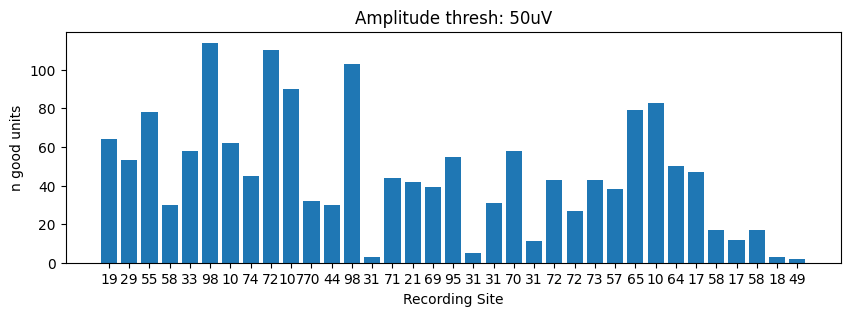

In [21]:
fig, ax = plt.subplots(1,1,figsize=(10,3))
ax.bar(np.arange(nrecs), [len(quality_metrics['final_good_unit_idx'][irec]) for irec in range(nrecs)])
ax.set(xlabel='Recording Site', ylabel='n good units', title=f"Amplitude thresh: {amp_thresh}uV")
ax.set_xticks(np.arange(nrecs), labels=preproc_metadata['recording_sites'].astype(int))
# ax.set(ylim=(0,120))

plt.show()

## Plot waveforms of units that pass QC metrics

  0%|          | 0/35 [00:00<?, ?it/s]

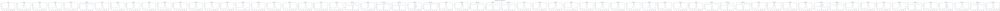

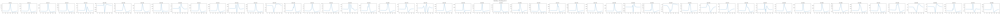

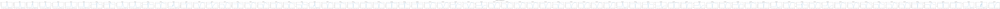

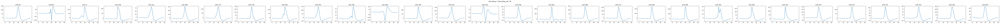

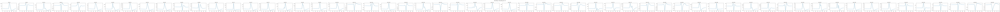

...

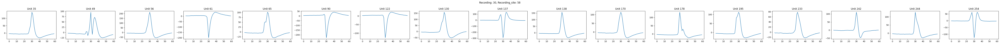

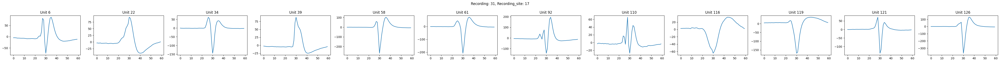

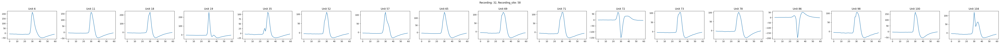

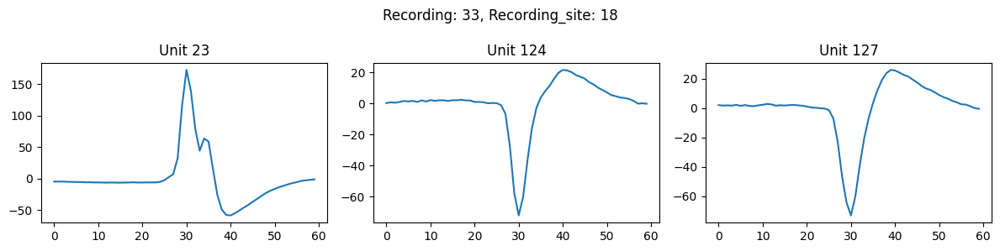

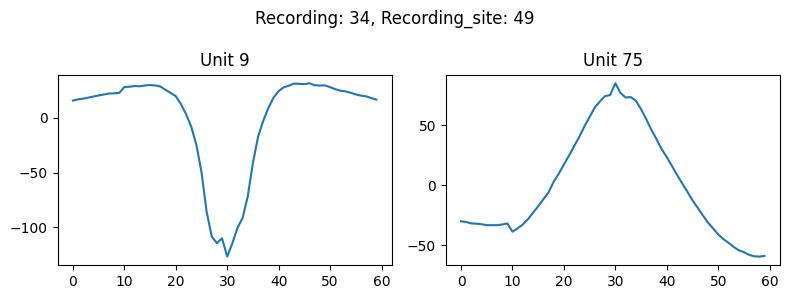

In [25]:
# Go back and load waveforms from the originally preprocessed neuropixel data
quality_metrics['mean_wfs'] = []
quality_metrics['position'] = []
unique_teid, unique_idx = np.unique(df['te_id'], return_index=True)
unique_dates = np.array(df['date'][unique_idx])
bits_to_microvolts = 0.1949999928474426
for ipenetration in tqdm(range(nrecs)):
    date = list(df[df['penetration']==ipenetration]['date'])[0]
    port = int(list(df[df['penetration']==ipenetration]['port'])[0])
    date_tes = np.unique(list(df[df['penetration']==ipenetration]['te_id']))
    recording_site = list(df[df['penetration']==ipenetration]['recording_site'])[0]
    if len(quality_metrics['final_good_unit_labels'][ipenetration]) > 0:    
        irec_wfs = {}
        irec_pos = {}
        temp_cnt = 0
        for ite in date_tes:
            # Load data
            if ite < 0:
                filename_mc = aopy.data.get_preprocessed_filename(subject, ite, date, 'ap')
                try:
                    ap_data = aopy.data.load_hdf_group(os.path.join(data_path_preproc, subject), filename_mc, 'ap')
                    ap_metadata = aopy.data.load_hdf_group(os.path.join(data_path_preproc, subject), filename_mc, 'metadata')
                    unit_labels = ap_data['unique_label']
                    spike_times = ap_data['unit'] # Assumes spike labels are consistent across recording sessions (works if recorded on the same day, but otherwise it does not)
                    waveforms = ap_data['waveform']
                    spike_pos = ap_data['pos']
                except:
                    print(f"Could not load data. (TE: {ite}, Date: {date})")

            else:
                filename_mc = aopy.data.get_preprocessed_filename(subject, ite, date, 'ap')
                filename_mc = filename_mc[:-6] + 'spike.hdf'
                try:
                    ap_data = aopy.data.load_hdf_group(os.path.join(data_path_preproc, subject), filename_mc, f'drive{port}/spikes')
                    ap_metadata = aopy.data.load_hdf_group(os.path.join(data_path_preproc, subject), filename_mc, f'drive{port}/metadata')
                    waveforms = aopy.data.load_hdf_group(os.path.join(data_path_preproc, subject), filename_mc, f'drive{port}/waveforms')
                    try:
                        spike_pos = aopy.data.load_hdf_group(os.path.join(data_path_preproc, subject), filename_mc, f'drive{port}/spike_pos')
                    except:
                        spike_pos = aopy.data.load_hdf_group(os.path.join(data_path_preproc, subject), filename_mc, f'drive{port}/metadata/')['spike_pos']
                    unit_labels = ap_metadata['unique_label']
                    spike_times = ap_data # Assumes spike labels are consistent across recording sessions (works if recorded on the same day, but otherwise it does not)
                except:
                    print(f"Could not load data. (TE: {ite}, Date: {date})")

            # concatenate data
            ngoodunits = len(quality_metrics['final_good_unit_labels'][ipenetration])
            for goodunit_label in quality_metrics['final_good_unit_labels'][ipenetration]:
                if temp_cnt == 0:
                    irec_wfs[str(goodunit_label)] = waveforms[str(goodunit_label)]
                    irec_pos[str(goodunit_label)] = spike_pos[str(goodunit_label)]
                else:
                    irec_wfs[str(goodunit_label)] = np.concatenate((irec_wfs[str(goodunit_label)], waveforms[str(goodunit_label)]), axis=0)

            temp_cnt += 1

        # plot waveforms 
        fig, ax = plt.subplots(1,ngoodunits, figsize=(ngoodunits*4,3))
        mean_wfs = np.zeros((len(quality_metrics['final_good_unit_labels'][ipenetration]),waveforms[str(unit_labels[0])].shape[1]))*np.nan
        unit_pos = np.zeros((len(quality_metrics['final_good_unit_labels'][ipenetration])))*np.nan
        for igoodunit, goodunit_label in enumerate(quality_metrics['final_good_unit_labels'][ipenetration]):
            cent_wfs = irec_wfs[str(goodunit_label)] - np.mean(irec_wfs[str(goodunit_label)], axis=1)[:,None,:] # Center each spike on each channel
            mean_wf = np.nanmean(cent_wfs, axis=0)*bits_to_microvolts # Mean across all spikes for each channel. becomes (ntime, nch) array

            p2p = np.abs(np.max(mean_wf, axis=0) - np.min(mean_wf, axis=0)) # Peak to peak amplitude for each channel
            mean_wfs[igoodunit, :] = mean_wf[:,np.argmax(p2p)]
            
            
            # max_ch = np.argmax(np.max(np.abs(np.mean(irec_wfs[str(goodunit_label)], axis=0)), axis=0))
            # mean_wf_temp = np.mean(irec_wfs[str(goodunit_label)][:,:,max_ch], axis=0)
            # mean_wfs[igoodunit, :] = mean_wf_temp
            unit_pos[igoodunit] = irec_pos[str(goodunit_label)][1]
            if len(quality_metrics['final_good_unit_labels'][ipenetration]) > 1:
                ax[igoodunit].plot(mean_wf[:,np.argmax(p2p)])
                ax[igoodunit].set(title=f"Unit {goodunit_label}")
            else:
                ax.plot(mean_wf[:,np.argmax(p2p)])
                ax.set(title=f"Unit {goodunit_label}")
        plt.suptitle(f"Recording: {ipenetration}, Recording_site: {recording_site}")
        fig.tight_layout()
        plt.show()
        
        quality_metrics['mean_wfs'].append(mean_wfs)
        quality_metrics['position'].append(unit_pos)
    else:
        quality_metrics['mean_wfs'].append([])
        quality_metrics['position'].append([])

In [26]:
# save_dir = "/media/moor-data/results/Ryan/neuropixel_targeting/np_analysis_preproc_data"
# teid_info = aopy.data.base.pkl_read("brain_surface_pos", save_dir)
# print(teid_info)

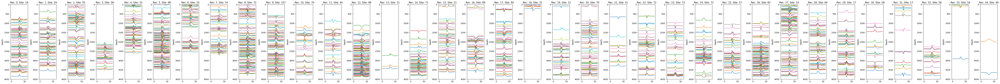

In [27]:
fig, ax = plt.subplots(1,nrecs,figsize=(2*nrecs,6))
for irec in range(nrecs):
    date = list(df[df['penetration']==irec]['date'])[0]
    port = int(list(df[df['penetration']==irec]['port'])[0])
    date_tes = np.unique(list(df[df['penetration']==irec]['te_id']))
    recording_site = int(list(df[df['penetration']==irec]['recording_site'])[0])
    # Compute surface pos
    # if subject == 'affi':
    #     surface_pos = int(teid_info['surface_pos'][teid_info['mc_id']==np.unique(df['te_id'])[irec]])
    # elif subject == 'beignet':
    #     surface_pos = 3840
    surface_pos = 3840
    # print(recording_site[irec], surface_pos)
    for iunit in range(len(quality_metrics['mean_wfs'][irec])):
        try:
            norm_wf = 100*quality_metrics['mean_wfs'][irec][iunit,:]/np.max(np.abs(quality_metrics['mean_wfs'][irec][iunit,:]))
            ax[irec].plot(surface_pos - (quality_metrics['position'][irec][iunit] + norm_wf))
        except:
            continue
    
    ax[irec].set(title=(f"Rec: {irec}, Site: {recording_site}"), ylabel='Depth', ylim=(0, 4000))
    ax[irec].invert_yaxis()
fig.tight_layout()
plt.show()

## Plot rasters for good units

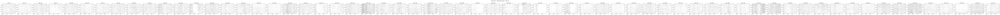

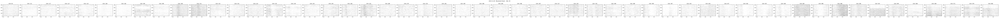

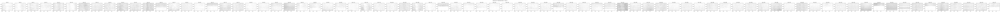

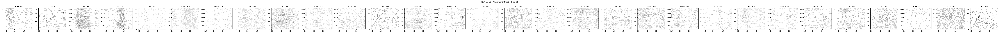

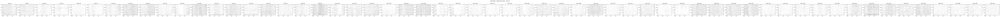

Error in callback <function _draw_all_if_interactive at 0x7f8b3d84fdc0> (for post_execute):



KeyboardInterrupt



Error in callback <function flush_figures at 0x7f89b944e5e0> (for post_execute):



KeyboardInterrupt



In [28]:
align_event = align_events[-1]
for irec in range(nrecs):
    date = list(df[df['penetration']==irec]['date'])[0]
    port = int(list(df[df['penetration']==irec]['port'])[0])
    date_tes = np.unique(list(df[df['penetration']==irec]['te_id']))
    recording_site = list(df[df['penetration']==irec]['recording_site'])[0]
    try: 
        nrasters = len(quality_metrics['mean_wfs'][irec])
        fig, ax = plt.subplots(1,nrasters, figsize=(nrasters*3,3))
        [ax[irast].pcolor(preproc_metadata['trial_time_axis'], np.arange(rasters['neural'][align_event][irec].shape[1]), rasters['neural'][align_event][irec][:,:,iunit].T, cmap='gray_r') for irast, iunit in enumerate(quality_metrics['final_good_unit_idx'][irec])]
        [ax[irast].set(title=f"Unit: {quality_metrics['final_good_unit_labels'][irec][irast]}", ylim=(0, np.where(df['good_trial'][df['penetration']==irec])[0][-1])) for irast in range(len(quality_metrics['final_good_unit_idx'][irec]))]
        plt.suptitle(f"{date} - Movement Onset -- Site: {recording_site}")
        fig.tight_layout()
        plt.show()
    except:
        continue

# Manually pick possible bad units based on waveform/raster

In [38]:
# Manually curate - remove axons and obvious artifacts
manual_bad_unit_labels = []
if subject == 'beignet':
    manual_bad_unit_labels.append([]) # site 11
    manual_bad_unit_labels.append([106,112])  #site 30
    manual_bad_unit_labels.append([177]) # site 47
    manual_bad_unit_labels.append([]) # site 9
    manual_bad_unit_labels.append([110,111,166,167,187,207,289,483,655,608,683])  # site 47
    manual_bad_unit_labels.append([42, 101, 270, 310, 402]) # site 40
    manual_bad_unit_labels.append([]) #site 18
    manual_bad_unit_labels.append([125,198]) #site 11
    manual_bad_unit_labels.append([]) # site 9
    manual_bad_unit_labels.append([168,190,257]) # site 121
    manual_bad_unit_labels.append([45]) #site 22
    manual_bad_unit_labels.append([58, 88,]) #site 9.2
    manual_bad_unit_labels.append([189]) #site 120
    manual_bad_unit_labels.append([11, 174])# Site 98
    manual_bad_unit_labels.append([]), # site 45
elif subject == 'affi':
    manual_bad_unit_labels.append([51, 544, 546]) # 0. site 19
    manual_bad_unit_labels.append([111, 180, 222, 536, 543, 569, 606]) # 1. site 29 
    manual_bad_unit_labels.append([57, 75,96,114, 252,309, 383, 395, 411, 420, 431]) # 2. site 55
    manual_bad_unit_labels.append([49, 72, 106, 175, 182, 351]) # 3. site 58
    manual_bad_unit_labels.append([58, 331,]) # 4. site 33
    manual_bad_unit_labels.append([265, 414]) # 5. site 98
    manual_bad_unit_labels.append([75, 261, 275]) # 6. site 10
    manual_bad_unit_labels.append([74, 91, 178]) # 7. site 74
    manual_bad_unit_labels.append([14,482 ]) # 8. site 72
    manual_bad_unit_labels.append([108, 110,133,210,214,]) # 9. site 107
    manual_bad_unit_labels.append([5,25, 277, 279, 280]) # 10. site 70
    manual_bad_unit_labels.append([90, 112, 113, 114]) # 11. site 44
    manual_bad_unit_labels.append([187, 218, ]) # 12. site 98
    manual_bad_unit_labels.append([35]) # 13. site 31
    manual_bad_unit_labels.append([71]) # 14. site 71
    manual_bad_unit_labels.append([42, 67,68,88, 112, 159, 210, 211]) # 15. site 21
    manual_bad_unit_labels.append([54, 215, 220, 222,232,253,248, 328, 331, 332]) # 16. site 69
    manual_bad_unit_labels.append([130, 174, 217, 236, 244, 299, 320, 390]) # 17. site 95
    manual_bad_unit_labels.append([303]) # 18. site 31
    manual_bad_unit_labels.append([69,146, 183 ]) # 19. site 31
    manual_bad_unit_labels.append([46, 62, 226, 227]) # 20. site 70
    manual_bad_unit_labels.append([]) # 21. site 31
    manual_bad_unit_labels.append([59, 64, 80, 127,138, 308, 334]) # 22. site 72
    manual_bad_unit_labels.append([132, 164]) # 23. site 72
    manual_bad_unit_labels.append([7,8,119, 166,182]) # 24. site 73
    manual_bad_unit_labels.append([16,90,111,205 ]) # 25. site 57
    manual_bad_unit_labels.append([105]) # 26. site 65
    manual_bad_unit_labels.append([81, 116, 219, 251,320,325,473]) # 27. site 10
    manual_bad_unit_labels.append([21, 301, 321]) # 28. site 64
    manual_bad_unit_labels.append([79, 236]) # 29. site 17
    manual_bad_unit_labels.append([138, 170, 178, 195, 244]) # 30. site 58
    manual_bad_unit_labels.append([34]) # 31. site 17
    manual_bad_unit_labels.append([19, 71]) # 32. site 58
    manual_bad_unit_labels.append([23]) # 33. site 18
    manual_bad_unit_labels.append([9, 75]) # 34. site 49

In [39]:
print([int(list(df[df['penetration']==irec]['recording_site'])[0]) for irec in range(nrecs)])
nrecs

[19, 29, 55, 58, 33, 98, 10, 74, 72, 107, 70, 44, 98, 31, 71, 21, 69, 95, 31, 31, 70, 31, 72, 72, 73, 57, 65, 10, 64, 17, 58, 17, 58, 18, 49]


35

In [40]:
quality_metrics['manual_good_unit_labels'] = []
quality_metrics['manual_good_unit_idx'] = []
quality_metrics['manual_position'] = []
quality_metrics['manual_wfs'] = []
for irec in range(nrecs):
    if len(quality_metrics['final_good_unit_labels'][irec]) > 0:
        manual_curation_mask = np.logical_not(np.isin(quality_metrics['final_good_unit_labels'][irec], manual_bad_unit_labels[irec]))
        quality_metrics['manual_good_unit_labels'].append(quality_metrics['final_good_unit_labels'][irec][manual_curation_mask])
        quality_metrics['manual_good_unit_idx'].append(quality_metrics['final_good_unit_idx'][irec][manual_curation_mask])
        quality_metrics['manual_position'].append(quality_metrics['position'][irec][manual_curation_mask])
        quality_metrics['manual_wfs'].append(quality_metrics['mean_wfs'][irec][manual_curation_mask,:])
    else:
        quality_metrics['manual_good_unit_labels'].append([])
        quality_metrics['manual_good_unit_idx'].append([])
        quality_metrics['manual_position'].append([])
        quality_metrics['manual_wfs'].append([])

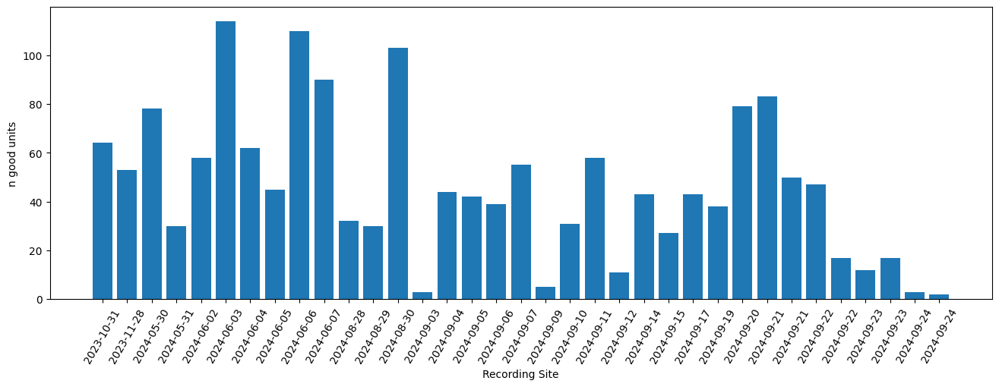

In [41]:
recording_sites = np.array([int(list(df[df['penetration']==irec]['recording_site'])[0]) for irec in range(nrecs)])
dates = np.array([list(df[df['penetration']==irec]['date'])[0] for irec in range(nrecs)])
fig, ax = plt.subplots(1,1,figsize=(16,5))
ax.bar(np.arange(nrecs), [len(quality_metrics['final_good_unit_idx'][irec]) for irec in range(nrecs)])
ax.set(xlabel='Recording Site', ylabel='n good units')
# ax.set_xticks(np.arange(nrecs), labels=recording_sites)
ax.set_xticks(np.arange(nrecs), labels=dates, rotation=60)
plt.show()

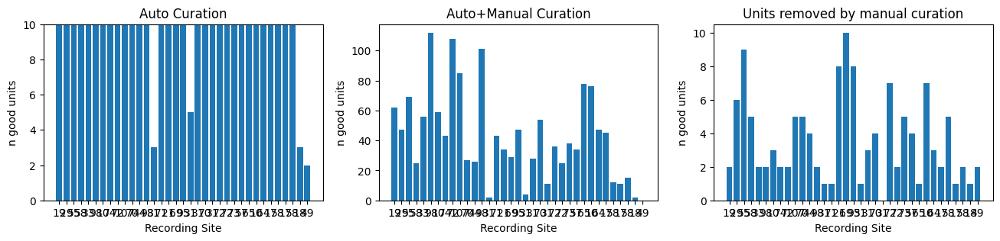

In [42]:
recording_sites = np.array([int(list(df[df['penetration']==irec]['recording_site'])[0]) for irec in range(nrecs)])
fig, ax = plt.subplots(1,3,figsize=(16,3))
ax[0].bar(np.arange(nrecs), [len(quality_metrics['final_good_unit_idx'][irec]) for irec in range(nrecs)])
ax[0].set(xlabel='Recording Site', ylabel='n good units', title=f"Auto Curation", ylim=(0,10))
ax[0].set_xticks(np.arange(nrecs), labels=recording_sites)

ax[1].bar(np.arange(nrecs), [len(quality_metrics['manual_good_unit_idx'][irec]) for irec in range(nrecs)])
ax[1].set(xlabel='Recording Site', ylabel='n good units', title=f"Auto+Manual Curation")
ax[1].set_xticks(np.arange(nrecs), labels=recording_sites)

ax[2].bar(np.arange(nrecs), [len(quality_metrics['final_good_unit_idx'][irec])-len(quality_metrics['manual_good_unit_idx'][irec]) for irec in range(nrecs)])
ax[2].set(xlabel='Recording Site', ylabel='n good units', title=f"Units removed by manual curation")
ax[2].set_xticks(np.arange(nrecs), labels=recording_sites)

plt.show()

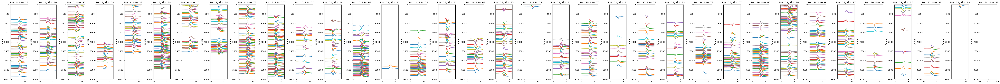

In [43]:
fig, ax = plt.subplots(1,nrecs,figsize=(2*nrecs,6))
for irec in range(nrecs):
    date = list(df[df['penetration']==irec]['date'])[0]
    port = int(list(df[df['penetration']==irec]['port'])[0])
    date_tes = np.unique(list(df[df['penetration']==irec]['te_id']))
    recording_site = int(list(df[df['penetration']==irec]['recording_site'])[0])
    for iunit in range(len(quality_metrics['mean_wfs'][irec])):
        if quality_metrics['final_good_unit_labels'][irec][iunit] in quality_metrics['manual_good_unit_labels'][irec]:
            norm_wf = -100*quality_metrics['mean_wfs'][irec][iunit,:]/np.max(np.abs(quality_metrics['mean_wfs'][irec][iunit,:]))
            ax[irec].plot(3840 - quality_metrics['position'][irec][iunit] + norm_wf)
    
    ax[irec].set(title=(f"Rec: {irec}, Site: {recording_site}"), ylabel='Depth', ylim=(0,4000))
    ax[irec].invert_yaxis()
fig.tight_layout()
plt.show()

# Get pseudopopulation info

In [44]:
ntrials = 400 #
def calc_presence_ratio_pseudopop(data, min_trial_prop=0.95, ntrials=400, return_details=False):
    '''
    This function finds the first ntrials that satisfy the presence ratio criteria

    Args:
        data (ntime, ntrials, nunit):
        min_trial_prop (float): proportion of trials a unit must have a spike on 
        
    Returns:
        present_trials (ntrial_wind, nunit): Trial range that first satisfies the presence ratio criteria. NaN if it is never satisfied
        trial_range_labels (ntrial_wind, 2): Trial numbers that correspond to the rows in 'present_trials'
        presence_details (ntrials, nunit): Optional if 'return_details=True' Identifies which trials each unit is active on 
    '''   
    _, ndata_trials, nunits = data.shape
    nwind = ndata_trials - ntrials
    
    trial_range_labels = np.zeros((nwind,2))*np.nan
    present_trials = np.zeros((nwind, nunits)).astype(bool)
    for iwind in range(nwind):
        start_trial_idx = iwind
        end_trial_idx = iwind+ntrials
        _, present_units, _ = calc_presence_ratio(data[:,start_trial_idx:end_trial_idx,:], min_trial_prop=min_trial_prop)
        
        trial_range_labels[iwind,:] = np.array([start_trial_idx, end_trial_idx])
        present_trials[iwind,:] = present_units
        
    return present_trials, trial_range_labels
        
       


# Save QC results

In [45]:
start = time.time()
aopy.data.base.pkl_write(f"{subject}_QCunits_eye_constrained", (quality_metrics, _), save_dir)
# aopy.data.base.pkl_write(f"{subject}_QCunits", (quality_metrics, drift), save_dir)
print(time.time()-start)

0.056344032287597656


In [98]:
start = time.time()
test = aopy.data.base.pkl_read(f"{subject}_QCunits_eyeconstrained", save_dir)
print(time.time()-start)

0.02457118034362793


In [ ]:
# print(test.keys())
# print(test[0])